# importing all libraries

In [1]:
import os
import re
import sys
import nltk
import itertools
import numpy as np 
import pandas as pd 
import seaborn as sns
from sklearn import tree
from sklearn.svm import SVC
from joblib import dump, load
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem import WordNetLemmatizer
from keras.models import Sequential,Model
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.naive_bayes import MultinomialNB
from sklearn.preprocessing import LabelEncoder
from keras.utils.np_utils import to_categorical
from sklearn.ensemble import AdaBoostClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer
from keras.layers import Dense,LSTM, SpatialDropout1D, Embedding

# Reading the Dataset

In [2]:
df = pd.read_csv(r'C:\Users\tejus\Desktop\New folder (5)\Finaldata.csv')
df

,Unnamed: 0,Resume,Category
0,0,HR ADMINISTRATOR/MARKETING ASSOCIATE\...,HR
1,1,"HR SPECIALIST, US HR OPERATIONS ...",HR
2,2,HR DIRECTOR Summary Over 2...,HR
3,3,HR SPECIALIST Summary Dedica...,HR
4,4,HR MANAGER Skill Highlights ...,HR
...,...,...,...
3441,957,Computer Skills: â¢ Proficient in MS office (...,Testing
3442,958,â Willingness to accept the challenges. â ...,Testing
3443,959,"PERSONAL SKILLS â¢ Quick learner, â¢ Eagerne...",Testing
3444,960,COMPUTER SKILLS & SOFTWARE KNOWLEDGE MS-Power ...,Testing


# List of all Categories

In [3]:
for i in range(len(df['Category'].unique())):
    print(df['Category'].unique()[i])

HR
DESIGNER
INFORMATION-TECHNOLOGY
TEACHER
ADVOCATE
BUSINESS-DEVELOPMENT
HEALTHCARE
FITNESS
AGRICULTURE
BPO
SALES
CONSULTANT
DIGITAL-MEDIA
AUTOMOBILE
CHEF
FINANCE
APPAREL
ENGINEERING
ACCOUNTANT
CONSTRUCTION
PUBLIC-RELATIONS
BANKING
ARTS
AVIATION
Data Science
Advocate
Arts
Web Designing
Mechanical Engineer
Sales
Health and fitness
Civil Engineer
Java Developer
Business Analyst
SAP Developer
Automation Testing
Electrical Engineering
Operations Manager
Python Developer
DevOps Engineer
Network Security Engineer
PMO
Database
Hadoop
ETL Developer
DotNet Developer
Blockchain
Testing


# Visualizing most commonly used words in each type of Resumes

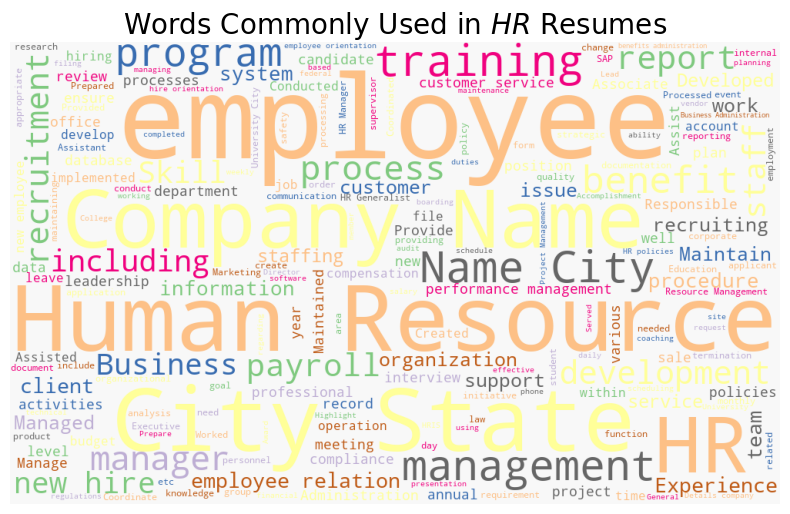

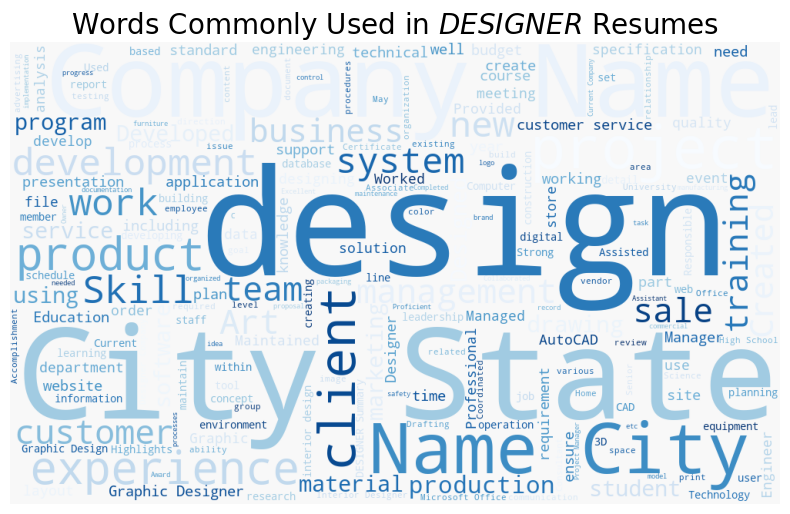

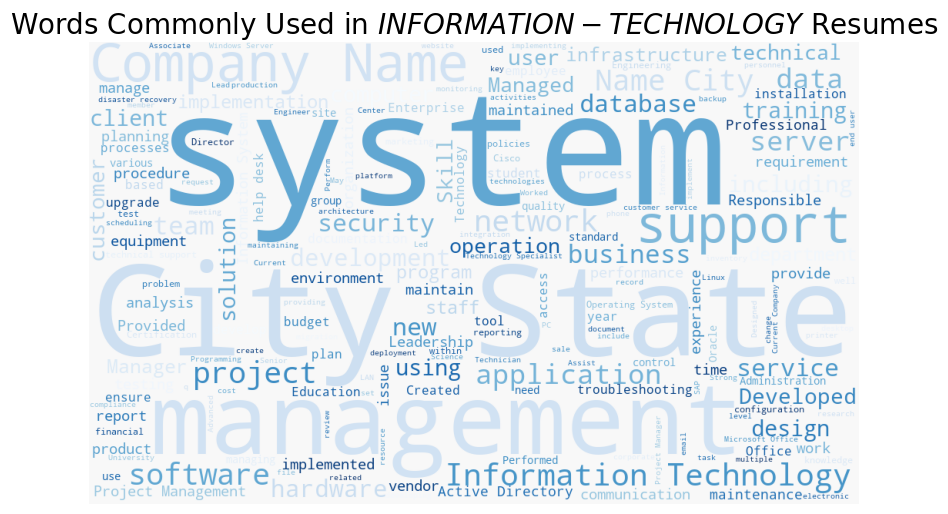

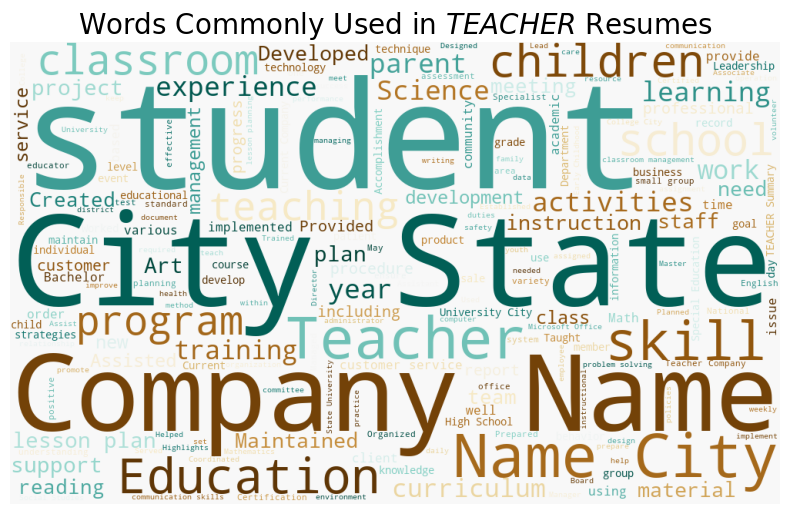

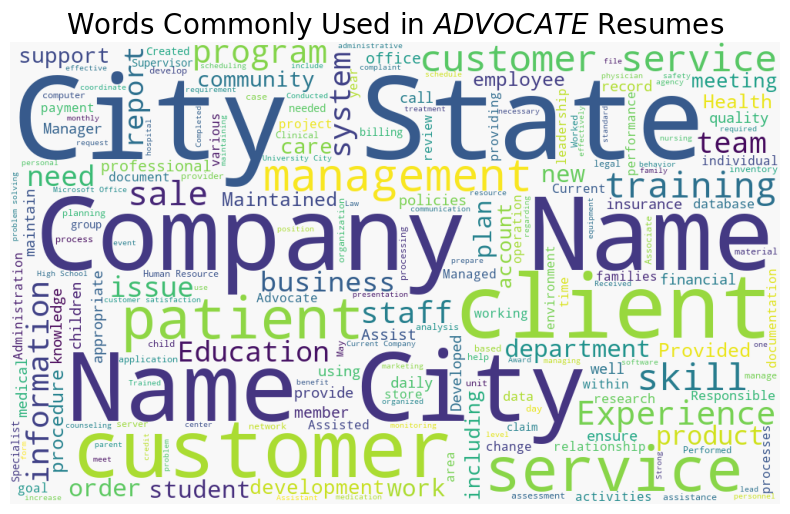

...

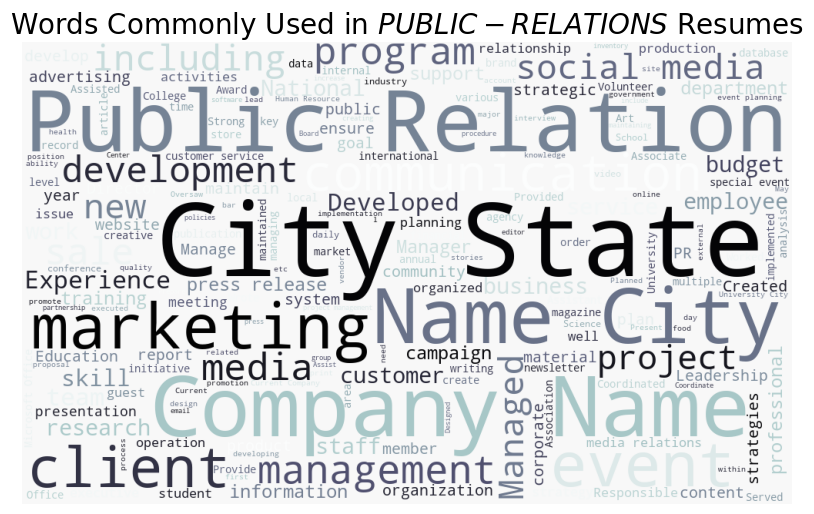

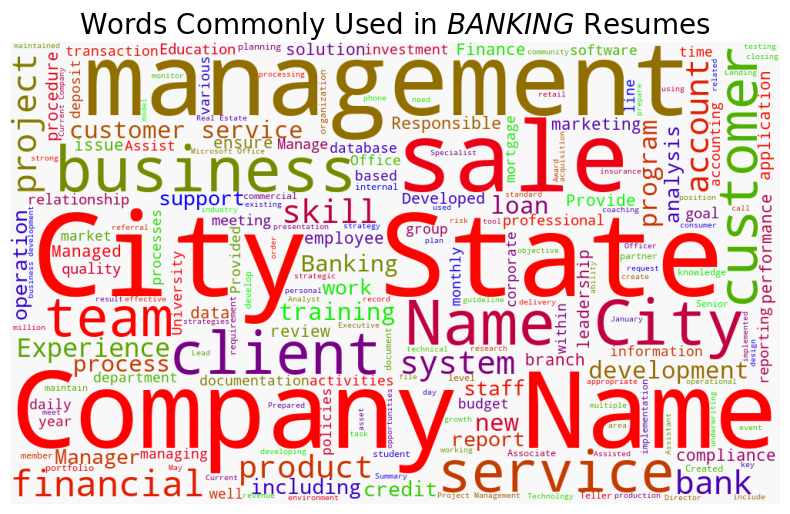

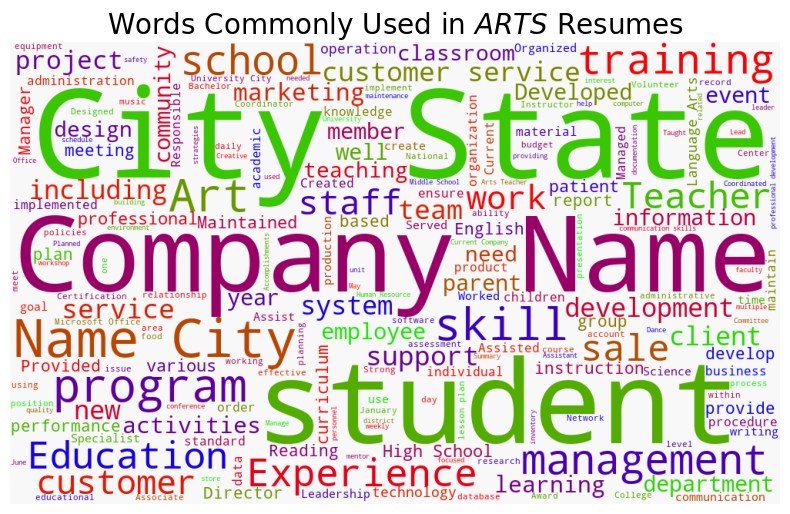

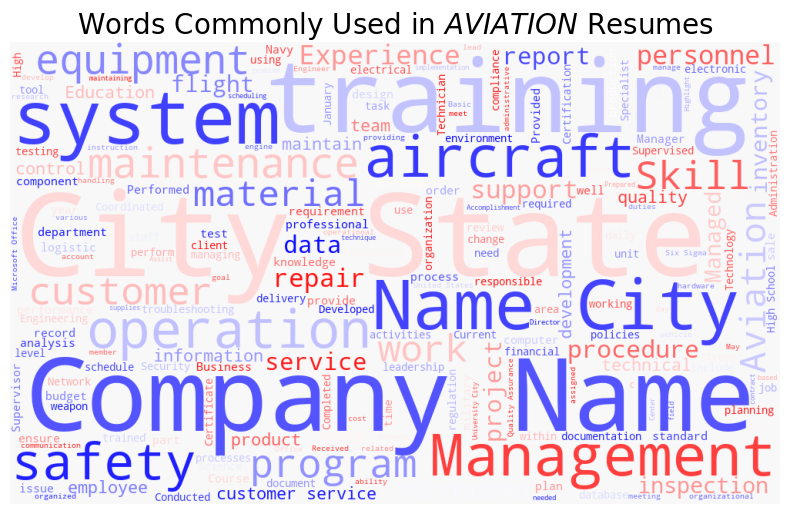

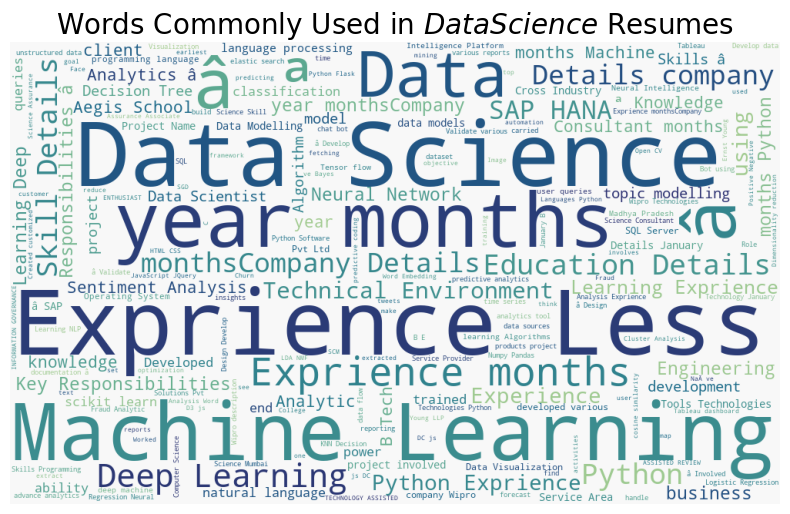

In [4]:
a=[ 'Accent_r', 'Blues', 'Blues_r', 'BrBG', 'viridis', 'viridis_r', 'vlag', 'vlag_r', 'winter', 'winter_r','BrBG_r', 'BuGn', 'BuGn_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 'bone_r', 'brg', 'brg_r', 'bwr', 'crest_r']
for label, cmap in zip(df['Category'].unique(), a):
    text = df.query("Category == @label")["Resume"].str.cat(sep=" ")
    plt.figure(figsize=(10, 6))
    wc = WordCloud(width=1000, height=600, background_color="#f8f8f8", colormap=cmap)
    wc.generate_from_text(text)
    plt.imshow(wc)
    plt.axis("off")
    plt.title(f"Words Commonly Used in ${label}$ Resumes", size=20)
    plt.show()

# Pre Processing

# Checking for missing data

In [5]:
print(df.isnull().sum())

Unnamed: 0    0
Resume        0
Category      0
dtype: int64


# Converting the data into lower case and removing words with small lengths

In [6]:
df['Resume'] = df['Resume'].apply(lambda x:x.lower())
for i in range(len(df)):
    lw=[]
    for j in df['Resume'][i].split():
        if len(j)>=3:                  
            lw.append(j)
    df['Resume'][i]=" ".join(lw)

C:\Users\tejus\AppData\Local\Temp\ipykernel_3460\4277992297.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Resume'][i]=" ".join(lw)


# removing punctuations

In [7]:
ps = list(";?.:!,")
df['Resume'] = df['Resume']

for p in ps:   
    df['Resume'] = df['Resume'].str.replace(p, '')

C:\Users\tejus\AppData\Local\Temp\ipykernel_3460\2980719137.py:5: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  df['Resume'] = df['Resume'].str.replace(p, '')


# Removing '\n' and '\t', extra spaces, quoting text and progressive pronouns

In [8]:
df['Resume'] = df['Resume'].str.replace("    ", " ")
df['Resume'] = df['Resume'].str.replace('"', '')
df['Resume'] = df['Resume'].apply(lambda x: x.replace('\t', ' '))
df['Resume'] = df['Resume'].str.replace("'s", "")
df['Resume'] = df['Resume'].apply(lambda x: x.replace('\n', ' '))

# Applying Lemmatization

In [9]:
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('omw-1.4')

[nltk_data] Error loading punkt: <urlopen error [Errno 11001]
[nltk_data]     getaddrinfo failed>
[nltk_data] Error loading wordnet: <urlopen error [WinError 10053] An
[nltk_data]     established connection was aborted by the software in
[nltk_data]     your host machine>
[nltk_data] Error loading omw-1.4: <urlopen error [WinError 10013] An
[nltk_data]     attempt was made to access a socket in a way forbidden
[nltk_data]     by its access permissions>


False

In [10]:
wl = WordNetLemmatizer()
nr = len(df)
lis = []
for r in range(0, nr):
    ll = []
    t = df.loc[r]['Resume']
    tw = str(t).split(" ")
    for w in tw:
        ll.append(wl.lemmatize(w, pos="v"))
    lt = " ".join(ll)
    lis.append(lt)

In [11]:
df['Resume'] = lis

# Removing Stop-words

In [12]:
nltk.download('stopwords')

[nltk_data] Error loading stopwords: <urlopen error [WinError 10013]
[nltk_data]     An attempt was made to access a socket in a way
[nltk_data]     forbidden by its access permissions>


False

In [13]:
sw = list(stopwords.words('english'))
for s in sw:
    rs = r"\b" + s + r"\b"
    df['Resume'] = df['Resume'].str.replace(rs, '')

C:\Users\tejus\AppData\Local\Temp\ipykernel_3460\2568322279.py:4: FutureWarning: The default value of regex will change from True to False in a future version.
  df['Resume'] = df['Resume'].str.replace(rs, '')


# Visualizing most commonly used words in Resumes after applying NLP techniques 

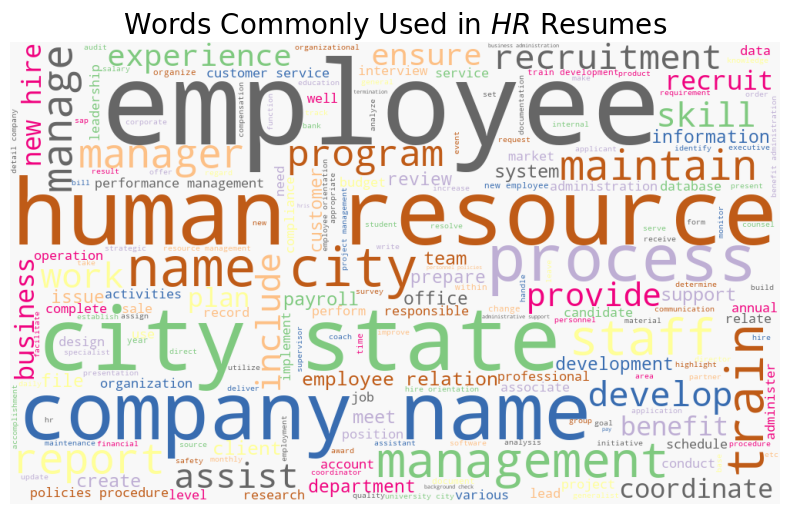

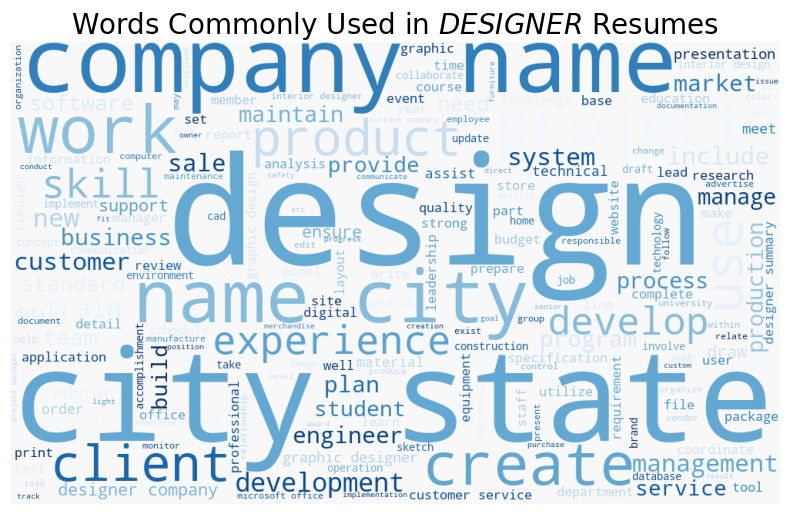

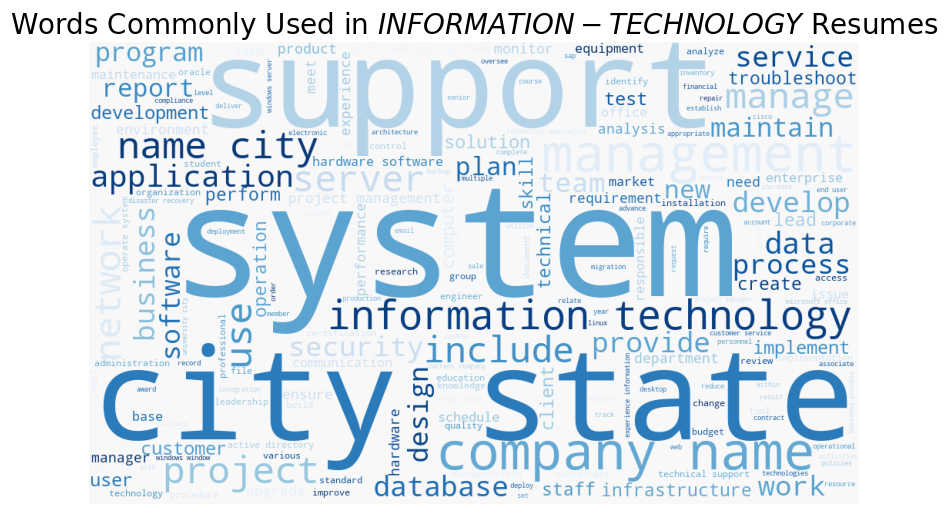

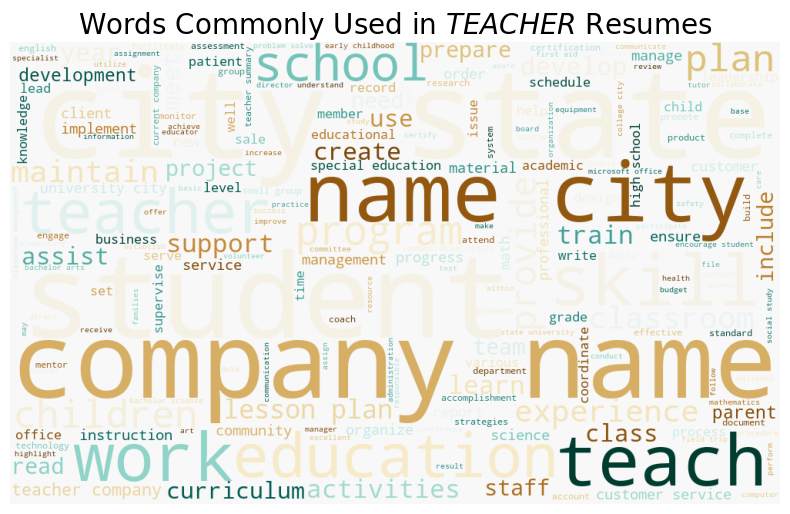

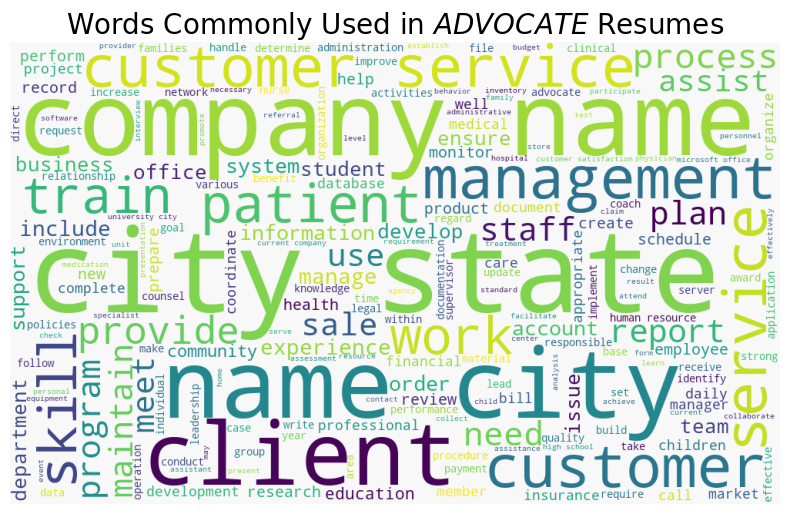

...

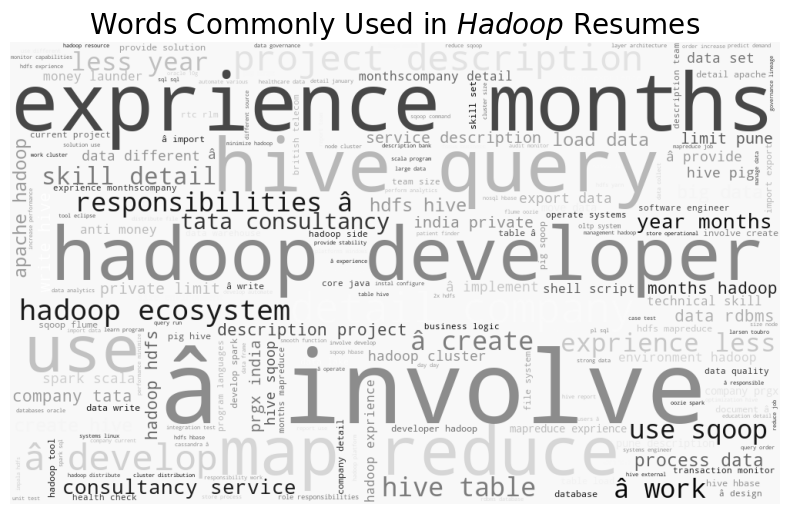

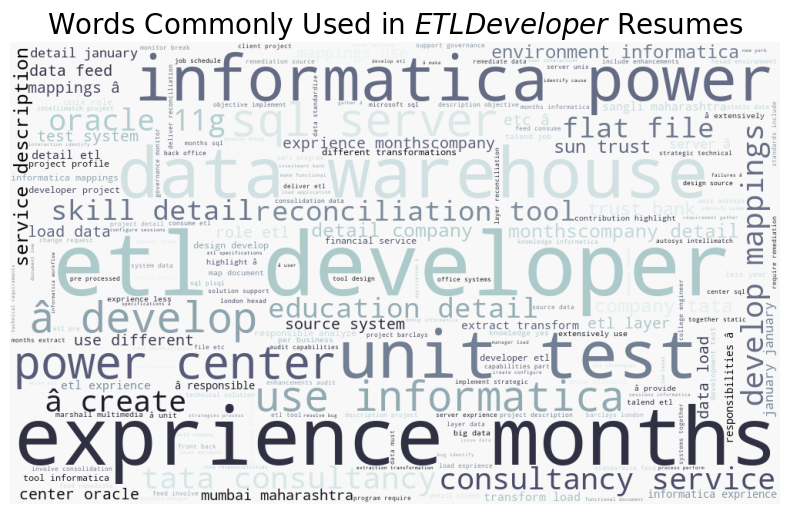

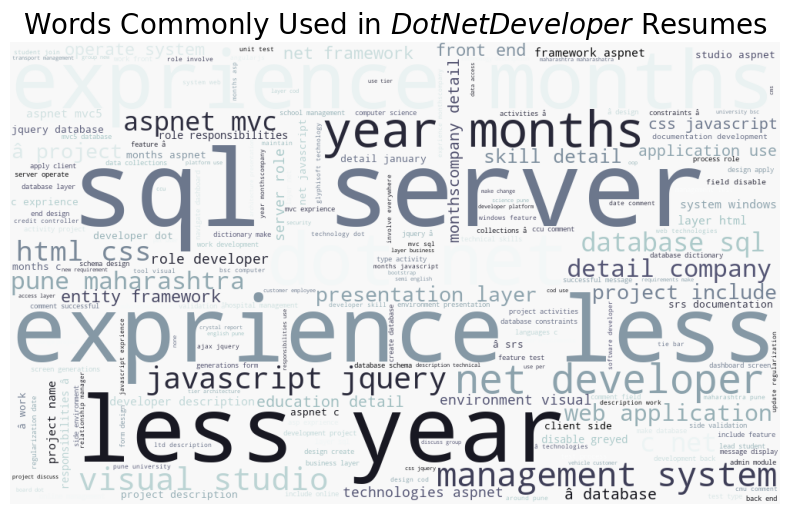

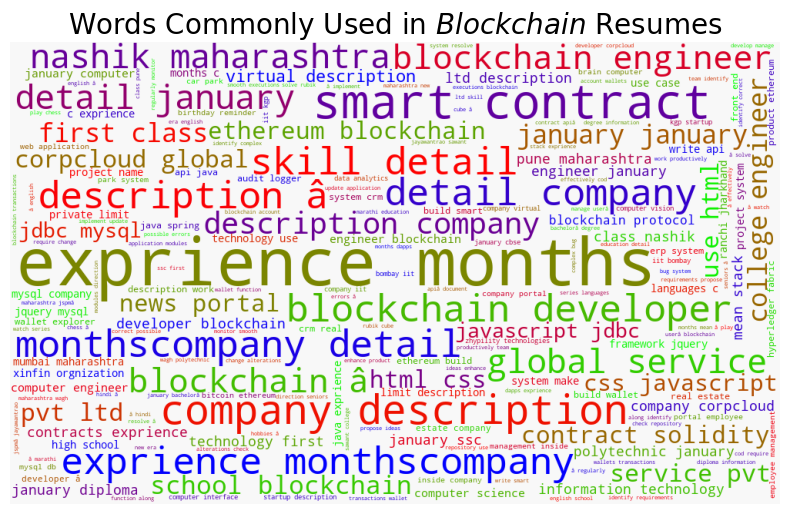

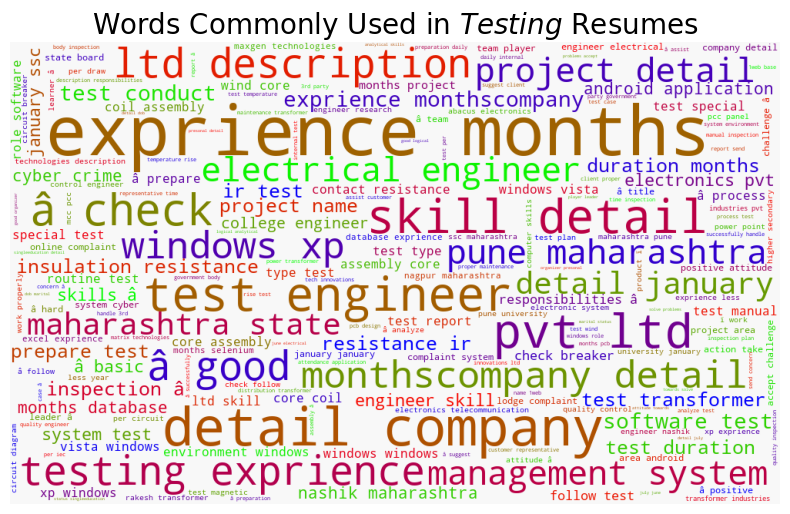

In [14]:
a=[ 'Accent_r', 'Blues', 'Blues_r', 'BrBG', 'viridis', 'viridis_r', 'vlag', 'vlag_r', 'winter', 'winter_r','BrBG_r', 'BuGn', 'BuGn_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 'bone_r', 'brg', 'brg_r', 'bwr', 'crest_r','Accent_r', 'Blues', 'Blues_r', 'BrBG', 'viridis', 'viridis_r', 'vlag', 'vlag_r', 'winter', 'winter_r','BrBG_r', 'BuGn', 'BuGn_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 'bone_r', 'brg', 'brg_r', 'bwr']
for label, cmap in zip(df['Category'].unique(), a):
    text = df.query("Category == @label")["Resume"].str.cat(sep=" ")
    plt.figure(figsize=(10, 6))
    wc = WordCloud(width=1000, height=600, background_color="#f8f8f8", colormap=cmap)
    wc.generate_from_text(text)
    plt.imshow(wc)
    plt.axis("off")
    plt.title(f"Words Commonly Used in ${label}$ Resumes", size=20)
    plt.show()

In [15]:
df.iloc[1,1]

'specialist operations summary versatile media professional  background communications market human resources  technology experience 09/2015 current specialist operations company name city state manage communication regard launch operations group policy change  system outages design standard work  job aid create comprehensive train program  new employees  contractors audit job post  old pending -hold  draft position audit union hourly non-union hourly  salary background check  drug screen conduct monthly new hire benefit brief new employees across  business units serve link  managers  vendors handle question  resolve system-related issue provide real-time process improvement feedback key metrics  initiatives successfully -branded operations sharepoint site business unit project manager  rfi/rfp background check  drug screen vendor 01/2014 05/2015  market  communications co-op company name city state post new article change  update corporate sharepoint site include graphics  visual comm

# Data Preparation for Training and Testing

# Encoding Labels

In [16]:
c = LabelEncoder()
df['Category'] = c.fit_transform(df['Category'])
le_name_mapping = dict(zip( c.transform(c.classes_),c.classes_))
print(le_name_mapping)

{0: 'ACCOUNTANT', 1: 'ADVOCATE', 2: 'AGRICULTURE', 3: 'APPAREL', 4: 'ARTS', 5: 'AUTOMOBILE', 6: 'AVIATION', 7: 'Advocate', 8: 'Arts', 9: 'Automation Testing', 10: 'BANKING', 11: 'BPO', 12: 'BUSINESS-DEVELOPMENT', 13: 'Blockchain', 14: 'Business Analyst', 15: 'CHEF', 16: 'CONSTRUCTION', 17: 'CONSULTANT', 18: 'Civil Engineer', 19: 'DESIGNER', 20: 'DIGITAL-MEDIA', 21: 'Data Science', 22: 'Database', 23: 'DevOps Engineer', 24: 'DotNet Developer', 25: 'ENGINEERING', 26: 'ETL Developer', 27: 'Electrical Engineering', 28: 'FINANCE', 29: 'FITNESS', 30: 'HEALTHCARE', 31: 'HR', 32: 'Hadoop', 33: 'Health and fitness', 34: 'INFORMATION-TECHNOLOGY', 35: 'Java Developer', 36: 'Mechanical Engineer', 37: 'Network Security Engineer', 38: 'Operations Manager', 39: 'PMO', 40: 'PUBLIC-RELATIONS', 41: 'Python Developer', 42: 'SALES', 43: 'SAP Developer', 44: 'Sales', 45: 'TEACHER', 46: 'Testing', 47: 'Web Designing'}


# Using TFIDF approach for converting the content in Resumes into vector form

In [17]:
from sklearn.feature_extraction.text import TfidfVectorizer
cv = TfidfVectorizer(max_features=20000)
X = cv.fit_transform(df['Resume'])
y = df['Category']

In [18]:
a = cv.get_feature_names_out()

In [19]:
import pickle
filename = 'cv.pickle'
#pickle.dump('cv.pickle',a)
#pickle.dump(cv, open(filename, 'wb'))

In [20]:
X.shape,y.shape

((3446, 20000), (3446,))

In [21]:
from imblearn.combine import SMOTETomek
from imblearn.under_sampling import NearMiss
smk = SMOTETomek(random_state=42)
X_res,y_res=smk.fit_resample(X,df['Category'])

In [22]:
X_res.shape,y_res.shape

((7384, 20000), (7384,))

# Splitting the Data using Stratified split

In [23]:
X_train, X_test, y_train, y_test = train_test_split(X_res, y_res, test_size = 0.25, stratify=y_res, random_state = 42)

In [24]:
X_train.shape,y_train.shape

((5538, 20000), (5538,))

In [25]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                              cmap=plt.cm.Greens):
    plt.figure(figsize=(50, 20), dpi=130)
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

In [26]:
print(X_test[0].shape)

(1, 20000)


# Using KNeighbors Classifier as the Model and printing evaluating it using confusion matrix

In [27]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV
model1=KNeighborsClassifier()
clf1=GridSearchCV(model1,{'n_neighbors':[1,2,3,4,5,6,7,8,9,10]})
clf1.fit(X_res,y_res)
clf1.cv_results_

{'mean_fit_time': array([0.02300196, 0.01920204, 0.01820168, 0.01760216, 0.01760101,
        0.0172019 , 0.01780114, 0.01880283, 0.01840229, 0.01860271]),
 'std_fit_time': array([0.00316246, 0.00263836, 0.00098033, 0.00049101, 0.00079864,
        0.00074839, 0.0003994 , 0.00074914, 0.0004909 , 0.00048909]),
 'mean_score_time': array([94.93740697, 85.03737731, 85.67797117, 80.34802589, 79.43755736,
        79.53116388, 79.57336731, 80.69694676, 80.11284714, 80.44923186]),
 'std_score_time': array([12.08463024,  9.67379821, 10.76467401,  8.79282498,  8.72188007,
         8.66397753,  8.58237914,  9.28328692,  8.93663882,  9.06910578]),
 'param_n_neighbors': masked_array(data=[1, 2, 3, 4, 5, 6, 7, 8, 9, 10],
              mask=[False, False, False, False, False, False, False, False,
                    False, False],
        fill_value='?',
             dtype=object),
 'params': [{'n_neighbors': 1},
  {'n_neighbors': 2},
  {'n_neighbors': 3},
  {'n_neighbors': 4},
  {'n_neighbors': 5},
  

In [28]:
pd1=pd.DataFrame(clf1.cv_results_)
pd1.to_csv('Knn.csv')

In [29]:
clf1 = KNeighborsClassifier(n_neighbors=1)
clf1 = clf1.fit(X_train, y_train)
yp = clf1.predict(X_test)
acc = accuracy_score(y_test, yp)
print("accuracy is: ",acc)


accuracy is:  0.8163596966413867


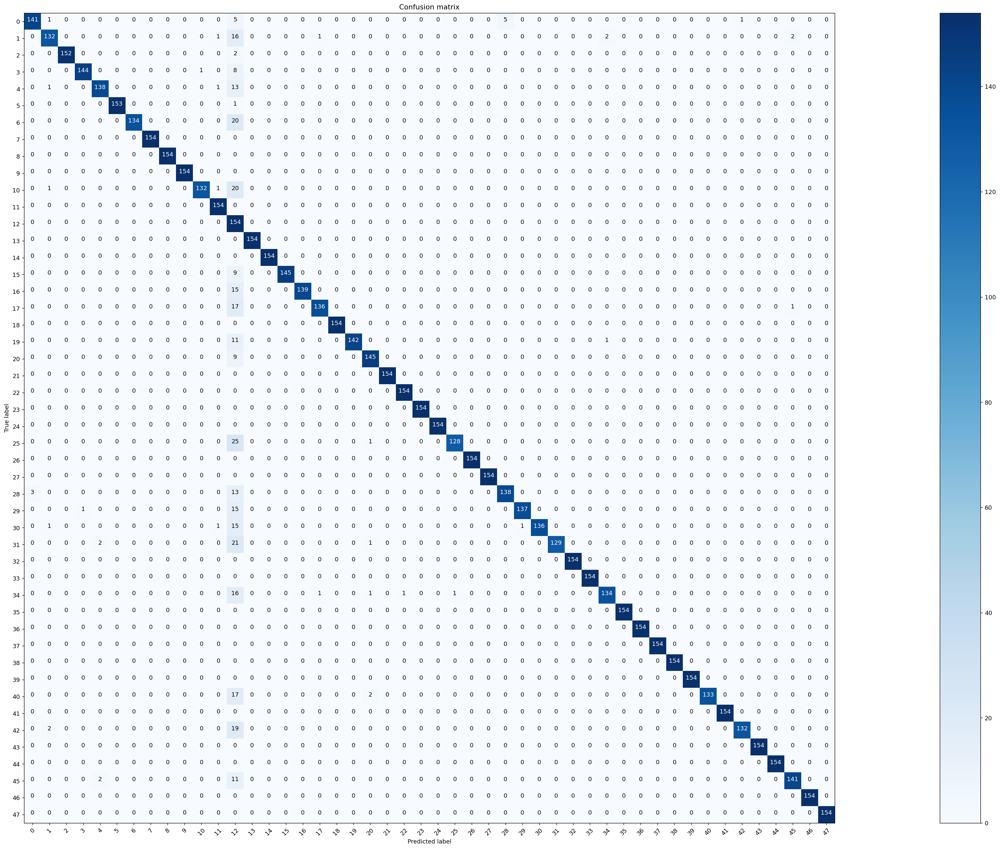

In [30]:
yc = clf1.predict(X_res)
CM = confusion_matrix(y_res, yc)
plot_confusion_matrix(CM, classes = range(48),cmap=plt.cm.Blues)
#dump(clf1, 'knei.joblib') 

In [31]:
from sklearn.metrics import precision_recall_fscore_support
s1 = precision_recall_fscore_support(y_res, yc,average='weighted')
s1

(0.9802799792226803, 0.9540899241603467, 0.9626118494303959, None)

# Using Decision tree as the Model and printing evaluating it using confusion matrix

In [32]:
from sklearn.tree import DecisionTreeClassifier
model2=DecisionTreeClassifier()
clf2=GridSearchCV(model2,{'max_depth':[10,20,30,40,50,60,70,80,90,100]},cv=5)
clf2.fit(X_res,y_res)
clf2.cv_results_

{'mean_fit_time': array([ 3.03602786,  6.16572189,  7.98119936,  8.81526127,  9.29289718,
         9.1370863 ,  9.16908932,  9.20669084,  9.17708955, 10.13783898]),
 'std_fit_time': array([0.35126067, 0.58408636, 0.38786401, 0.21551566, 0.13702134,
        0.21584638, 0.19919666, 0.17356091, 0.27586742, 0.80407861]),
 'mean_score_time': array([0.02560124, 0.02400246, 0.02300196, 0.02320266, 0.02300153,
        0.02360201, 0.02340078, 0.02380161, 0.02280207, 0.02440329]),
 'std_score_time': array([0.00431824, 0.00379441, 0.00384593, 0.00337089, 0.00340576,
        0.00332233, 0.00338302, 0.00430919, 0.00348667, 0.00608888]),
 'param_max_depth': masked_array(data=[10, 20, 30, 40, 50, 60, 70, 80, 90, 100],
              mask=[False, False, False, False, False, False, False, False,
                    False, False],
        fill_value='?',
             dtype=object),
 'params': [{'max_depth': 10},
  {'max_depth': 20},
  {'max_depth': 30},
  {'max_depth': 40},
  {'max_depth': 50},
  {'max_d

In [33]:
pd2=pd.DataFrame(clf2.cv_results_)
pd2.to_csv('DT.csv')

accuracy is:  0.828819068255688


['DT.joblib']

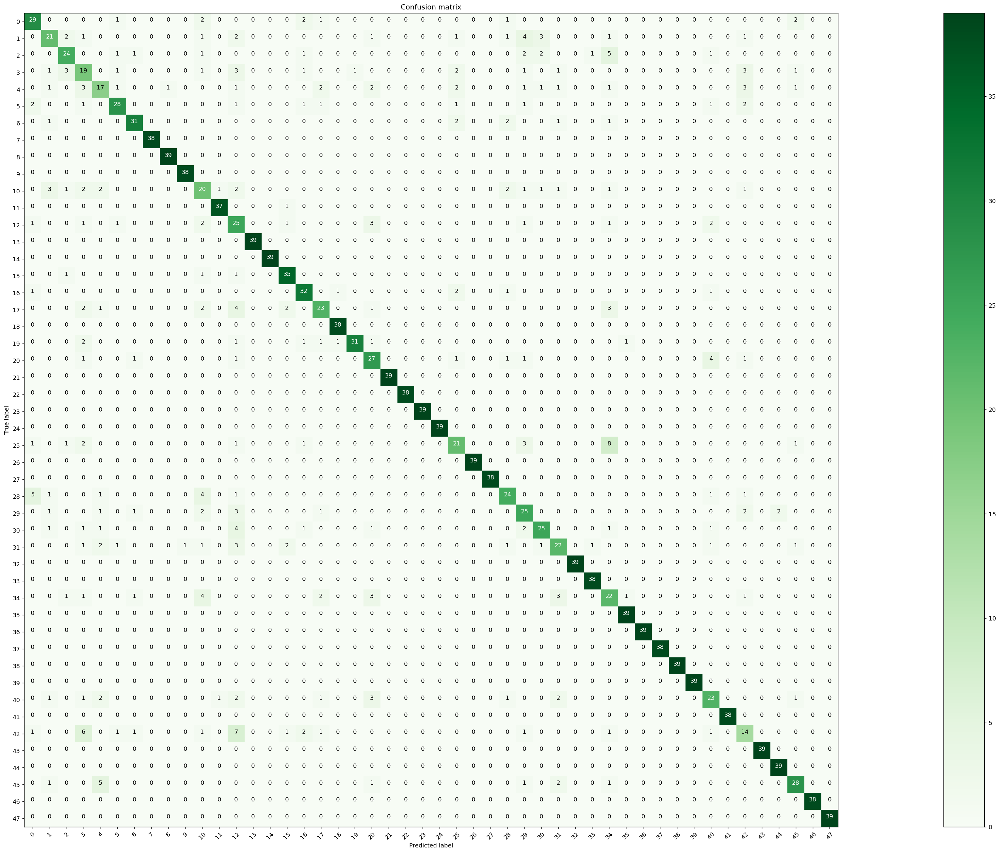

In [34]:
clf2 = tree.DecisionTreeClassifier(max_depth=100)
clf2 = clf2.fit(X_train, y_train)
yp = clf2.predict(X_test)
acc = accuracy_score(y_test, yp)
print("accuracy is: ",acc)
CM = confusion_matrix(y_test, yp)
plot_confusion_matrix(CM, classes = range(48))
dump(clf2, 'DT.joblib') 

In [35]:
yp2 = clf2.predict(X_res)

In [36]:
from sklearn.metrics import precision_recall_fscore_support
s2 = precision_recall_fscore_support(y_res, yp2,average='weighted')
s2

(0.9578262179030678, 0.957204767063922, 0.957290394101915, None)

In [37]:
from sklearn.ensemble import RandomForestClassifier
model3=RandomForestClassifier()
clf3=GridSearchCV(model3,{'n_estimators':[10,50,100,300,500]},cv=5)
clf3.fit(X_res,y_res)

GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'n_estimators': [10, 50, 100, 300, 500]})

In [38]:
clf3.best_estimator_

RandomForestClassifier(n_estimators=500)

In [39]:
pd3=pd.DataFrame(clf3.cv_results_)
pd3.to_csv('RF.csv')

In [40]:
clf4=RandomForestClassifier(n_estimators = 500)
clf4 = clf4.fit(X_train, y_train)
yp = clf4.predict(X_test)
acc = accuracy_score(y_test, yp)
print("accuracy is: ",acc)
dump(clf4, 'RF.joblib') 

accuracy is:  0.9165763813651138


['RF.joblib']

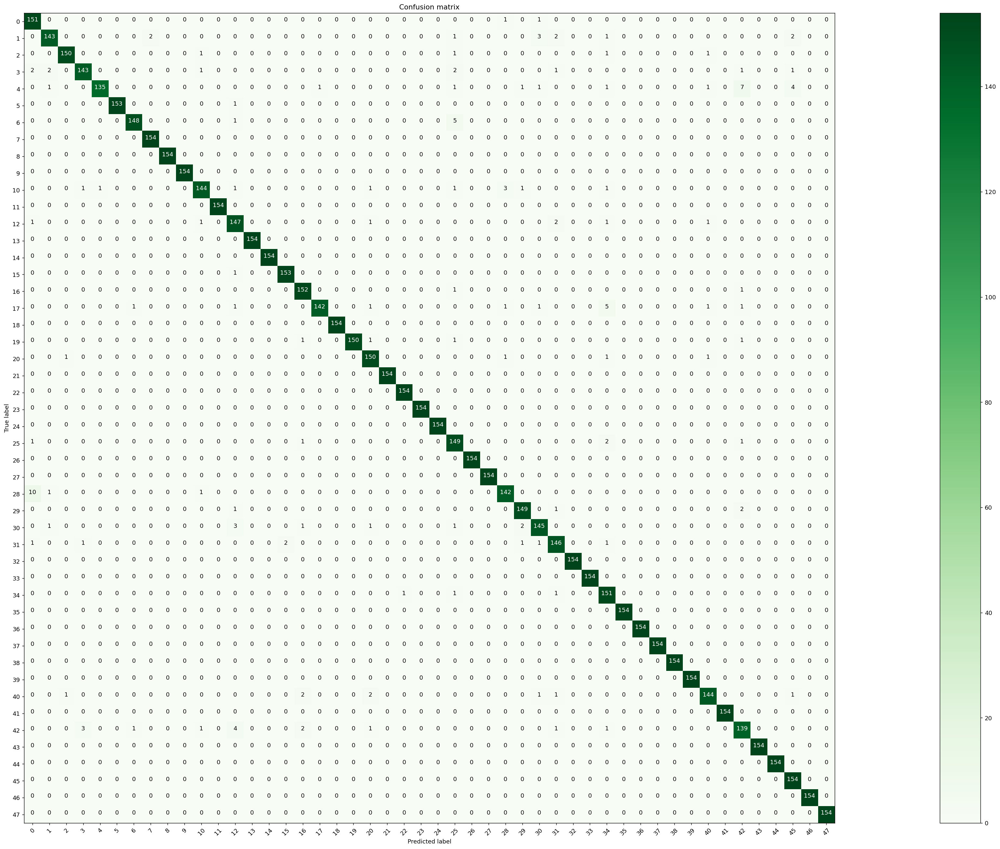

In [41]:
yp4 = clf4.predict(X_res)
CM = confusion_matrix(y_res, yp4)
plot_confusion_matrix(CM, classes = range(48))

In [42]:
from sklearn.metrics import precision_recall_fscore_support
s3 = precision_recall_fscore_support(y_res, yp4,average='weighted')
s3

(0.9796120396611581, 0.9791440953412784, 0.9791360688356763, None)

In [43]:
from sklearn.svm import SVC
model4=SVC()
clf4 = GridSearchCV(model4,{'C':[0.01,0.1,0.5,1],'kernel':['linear','poly','rbf','sigmoid']})
clf4.fit(X_res,y_res)
clf4.cv_results_

{'mean_fit_time': array([116.29444818, 112.3978476 , 115.51308208, 117.95577984,
         69.43140726,  92.76355829,  85.58942142,  72.32922463,
         40.27162189,  72.78686113,  53.79263535,  38.39468322,
         36.40693359,  71.11653585,  52.41973257,  32.67845244]),
 'std_fit_time': array([3.39245767, 3.86775472, 3.17421471, 3.81808161, 1.74566758,
        2.02629328, 1.42348705, 1.57611642, 0.9787542 , 0.74841427,
        0.81576255, 0.65872912, 0.88994719, 0.66030065, 1.2646285 ,
        0.57042523]),
 'mean_score_time': array([15.78138208, 15.68875532, 15.95184627, 15.90861511, 13.53141499,
        13.99444971, 14.14539504, 13.66102386, 10.21096578, 11.04492846,
        10.06915307,  9.64812078,  9.53911381,  9.83073659,  9.11888328,
         8.59704485]),
 'std_score_time': array([0.97951621, 0.54548859, 0.52799516, 0.57629455, 0.56052066,
        0.59075202, 0.52272149, 0.47901866, 0.43816589, 0.43731765,
        0.46997966, 0.42062184, 0.4437833 , 0.54343258, 0.55911697,


In [44]:
pd4=pd.DataFrame(clf4.cv_results_)
pd4.to_csv('SVC.csv')

In [45]:
clf4.best_params_

{'C': 1, 'kernel': 'rbf'}

In [46]:

clf3=SVC(C=1, kernel= 'rbf')
clf3 = clf3.fit(X_train, y_train)
yp = clf3.predict(X_test)
acc = accuracy_score(y_test, yp)
print("accuracy is: ",acc)
dump(clf3, 'SVC.joblib') 



accuracy is:  0.9062838569880823


['SVC.joblib']

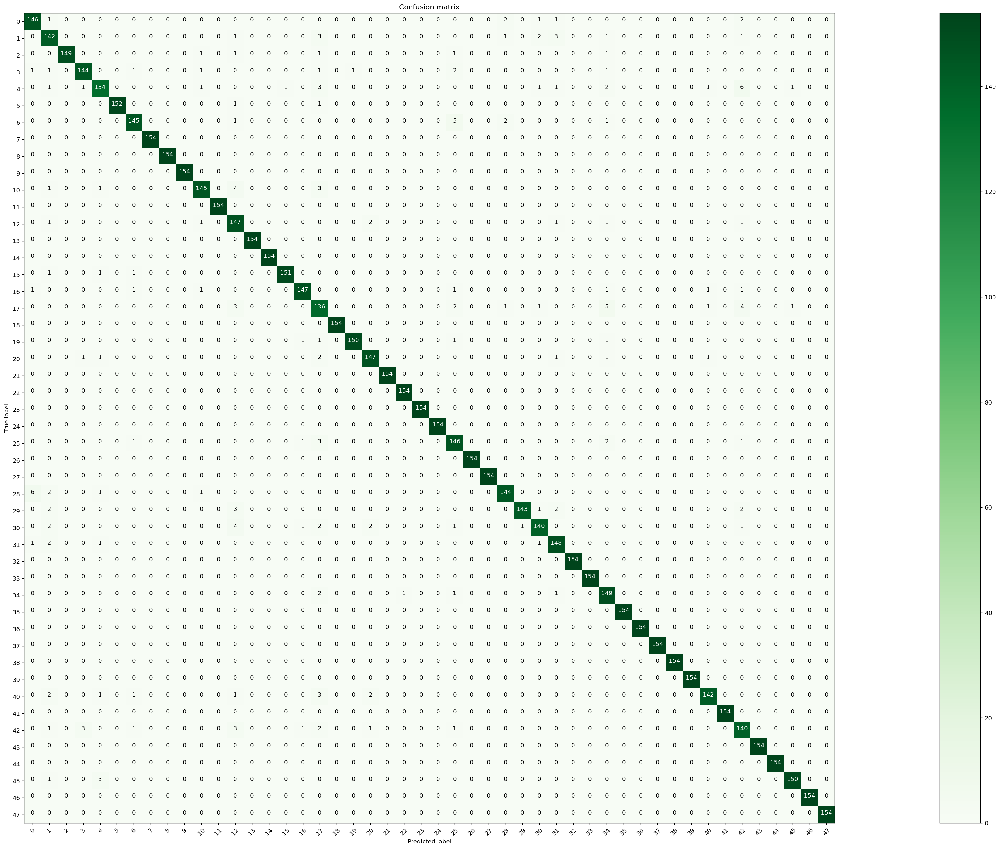

In [47]:
yp3 = clf3.predict(X_res)
CM = confusion_matrix(y_res, yp3)
plot_confusion_matrix(CM, classes = range(48))

In [48]:
from sklearn.metrics import precision_recall_fscore_support
s4 = precision_recall_fscore_support(y_res, yp3,average='weighted')
s4

(0.9740377206901666, 0.9733206933911159, 0.973485813908712, None)

In [49]:
import xgboost as xgb
xgb_classifier = xgb.XGBClassifier()
xgb_classifier.fit(X_train,y_train)
predictions = xgb_classifier.predict(X_test)
print("Accuracy of Model::",accuracy_score(y_test,predictions))

Accuracy of Model:: 0.9030335861321777
